# Tarea Nro. 2 - PANDAS

- Nombre y Apellido: Luisa Bermeo
- Fecha:  17/11/20

En esta tarea se examinara datos de terremotos. Comience importando pandas, numpy y matplolib.

Los datos de los terremotos están localizados en usgs_terremotos_2014.csv. Ni siquiera necesita descargalo, puede abrilo directamente con Pandas.

A continuación resuelva los siguientes items. 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

### 1) Use la función read_csv de Pandas directamente en esta url para abrirla como un DataFrame

(No use ninguna opción especial). Mostrar las primeras filas y la información del marco de datos.
Debería haber visto que las fechas no se analizaron automáticamente en tipos de fecha y hora.

In [2]:
data_df = pd.read_csv('usgs_terremotos_2014.csv')
data_df.head()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,id,updated,place,type
0,2014-01-31 23:53:37.000,60.252000,-152.7081,90.20,1.10,ml,NaN,NaN,NaN,0.2900,ak,ak11155107,2014-02-05T19:34:41.515Z,"26km S of Redoubt Volcano, Alaska",earthquake
1,2014-01-31 23:48:35.452,37.070300,-115.1309,0.00,1.33,ml,4.0,171.43,0.34200,0.0247,nn,nn00436847,2014-02-01T01:35:09.000Z,"32km S of Alamo, Nevada",earthquake
2,2014-01-31 23:47:24.000,64.671700,-149.2528,7.10,1.30,ml,NaN,NaN,NaN,1.0000,ak,ak11151142,2014-02-01T00:03:53.010Z,"12km NNW of North Nenana, Alaska",earthquake
3,2014-01-31 23:30:54.000,63.188700,-148.9575,96.50,0.80,ml,NaN,NaN,NaN,1.0700,ak,ak11151135,2014-01-31T23:41:25.007Z,"22km S of Cantwell, Alaska",earthquake
4,2014-01-31 23:30:52.210,32.616833,-115.6925,10.59,1.34,ml,6.0,285.00,0.04321,0.2000,ci,ci37171541,2014-02-01T00:13:20.107Z,"10km WNW of Progreso, Mexico",earthquake


### 2) Vuelva a leer los datos de tal manera que todas las columnas de fechas se identifiquen como fechas y la identificación del terremoto se use como índice

In [3]:
data_df = pd.read_csv('usgs_terremotos_2014.csv',parse_dates=['time', 'updated'],index_col='id')
data_df.head()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,updated,place,type
id,,,,,,,,,,,,,,
ak11155107,2014-01-31 23:53:37.000,60.252000,-152.7081,90.20,1.10,ml,NaN,NaN,NaN,0.2900,ak,2014-02-05 19:34:41.515000+00:00,"26km S of Redoubt Volcano, Alaska",earthquake
nn00436847,2014-01-31 23:48:35.452,37.070300,-115.1309,0.00,1.33,ml,4.0,171.43,0.34200,0.0247,nn,2014-02-01 01:35:09+00:00,"32km S of Alamo, Nevada",earthquake
ak11151142,2014-01-31 23:47:24.000,64.671700,-149.2528,7.10,1.30,ml,NaN,NaN,NaN,1.0000,ak,2014-02-01 00:03:53.010000+00:00,"12km NNW of North Nenana, Alaska",earthquake
ak11151135,2014-01-31 23:30:54.000,63.188700,-148.9575,96.50,0.80,ml,NaN,NaN,NaN,1.0700,ak,2014-01-31 23:41:25.007000+00:00,"22km S of Cantwell, Alaska",earthquake
ci37171541,2014-01-31 23:30:52.210,32.616833,-115.6925,10.59,1.34,ml,6.0,285.00,0.04321,0.2000,ci,2014-02-01 00:13:20.107000+00:00,"10km WNW of Progreso, Mexico",earthquake


### 3) Obtener las estadísticas básicas de todas las columnas

In [4]:
data_df.describe()

,latitude,longitude,depth,mag,nst,gap,dmin,rms
count,120108.000000,120108.000000,120107.000000,120065.000000,59688.000000,94935.000000,85682.000000,119716.000000
mean,38.399579,-99.961402,28.375029,1.793958,17.878284,124.048978,0.893198,0.358174
std,21.938258,82.996858,62.215416,1.343466,14.911369,68.518595,2.903966,0.364046
min,-73.462000,-179.998900,-9.900000,-0.970000,0.000000,9.000000,0.000000,0.000000
25%,34.228917,-147.742025,4.100000,0.820000,8.000000,74.000000,0.020760,0.070000
50%,38.805300,-120.832000,9.200000,1.400000,14.000000,107.000000,0.073670,0.200000
75%,53.889500,-116.068100,22.880000,2.400000,22.000000,155.000000,0.447000,0.590000
max,86.651400,179.998000,697.360000,8.200000,365.000000,356.400000,64.498000,8.460000


### 4) Obtener los 20 terremotos más importantes por magnitud

Examina la estructura de la columna `place`. La información del país parece estar allí. ¿Cómo lo sacarías?

In [5]:
byMagnitud = data_df.sort_values("mag", ascending=False)[:20]
byMagnitud

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,updated,place,type
id,,,,,,,,,,,,,,
usc000nzvd,2014-04-01 23:46:47.260,-19.6097,-70.7691,25.00,8.2,mww,NaN,23.0,0.609,0.66,us,2015-07-30 16:24:51.223000+00:00,"94km NW of Iquique, Chile",earthquake
usc000rki5,2014-06-23 20:53:09.700,51.8486,178.7352,109.00,7.9,mww,NaN,22.0,0.133,0.71,us,2015-04-18 21:54:08.699000+00:00,"19km SE of Little Sitkin Island, Alaska",earthquake
usc000p27i,2014-04-03 02:43:13.110,-20.5709,-70.4931,22.40,7.7,mww,NaN,44.0,1.029,0.82,us,2015-06-06 07:31:05.755000+00:00,"53km SW of Iquique, Chile",earthquake
usc000phx5,2014-04-12 20:14:39.300,-11.2701,162.1481,22.56,7.6,mww,NaN,13.0,2.828,0.71,us,2015-04-18 21:54:27.398000+00:00,"93km SSE of Kirakira, Solomon Islands",earthquake
usb000pr89,2014-04-19 13:28:00.810,-6.7547,155.0241,43.37,7.5,mww,NaN,16.0,3.820,1.25,us,2015-04-18 21:54:18.633000+00:00,"70km SW of Panguna, Papua New Guinea",earthquake
usc000piqj,2014-04-13 12:36:19.230,-11.4633,162.0511,39.00,7.4,mww,NaN,17.0,2.885,1.00,us,2015-08-13 19:29:13.018000+00:00,"112km S of Kirakira, Solomon Islands",earthquake
usb000slwn,2014-10-14 03:51:34.460,12.5262,-88.1225,40.00,7.3,mww,NaN,18.0,1.078,0.70,us,2015-08-13 19:35:02.679000+00:00,"74km S of Intipuca, El Salvador",earthquake
usb000pq41,2014-04-18 14:27:24.920,17.3970,-100.9723,24.00,7.2,mww,NaN,46.0,2.250,1.20,us,2015-08-13 19:30:39.599000+00:00,"33km ESE of Petatlan, Mexico",earthquake
usc000pft9,2014-04-11 07:07:23.130,-6.5858,155.0485,60.53,7.1,mww,NaN,21.0,3.729,0.88,us,2014-07-01 02:37:56+00:00,"56km WSW of Panguna, Papua New Guinea",earthquake


### 5) Extraiga el país utilizando las funciones de datos de texto de Pandas 

Agréguelo como una nueva columna al dataframe. (¿Es realmente solo un país? No, algunas filas tienen el nombre de un estado de EE. UU.) Corrija esto https://www.geeksforgeeks.org/python-pandas-working-with-text-data/. 

Otra librería que puede ser útil https://pypi.org/project/us/ para identificar si es un estado de EEUU es `us`



In [6]:
import us

# Funcion que devuelve "EE.UU" si el valor es un estado o region de EE.UU
def cleanStates(value):
    if value:
        return "EE.UU" if us.states.lookup(value.strip()) else value.strip()
    else:
        return value

# Funcion que extrae el nombre de los paises y estados de la columna Place
def cleanPlace(value):
    trash = ["southern", "western", "eastern", "northern",
             "of", "south", "west", "east", "north", "the", "region", "central", "offshore"]

    if value:
        if value.strip() != "":
            tokens = value.split(",")

            for token in tokens[1:]:
                for retoken in token.split(" "):
                    state = us.states.lookup(retoken.lower())
                    if state != None:
                        return state.name

            pais = tokens[-1]
            newPais = []
            for token in pais.split(" "):
                if token.lower() not in trash:
                    newPais.append(token)

            newPaisStr = ' '.join(newPais).strip()
            return newPaisStr if newPaisStr != "" else "UNDEFINED"
        elif value.strip() == "":
            return "UNDEFINED"
        else:
            return value.strip()
    else:
        return "UNDEFINED"

In [7]:
# Limpiamos los lugares que esten vacios y nulos
data_df.dropna(axis=0, subset=["place"], inplace=True)
isEmpty = data_df["place"].apply(lambda x: x.strip() == "")
data_df = data_df.drop(data_df[isEmpty].index)
data_df = data_df.drop(data_df[data_df["type"] != "earthquake"].index)

In [8]:
# Extremos los paises y estados en una nueva columna
data_df["pais"] = data_df["place"].apply(lambda x: cleanPlace(x))
data_df.sample(10)

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,updated,place,type,pais
id,,,,,,,,,,,,,,,
ak11270157,2014-05-23 05:53:57.000,65.0082,-150.1986,14.3000,0.80,ml,12.0,136.799989,0.229969,0.7400,ak,2014-06-03 15:43:46.836000+00:00,"20km E of Manley Hot Springs, Alaska",earthquake,Alaska
nn00455072,2014-07-28 22:02:02.702,39.7524,-120.6126,0.3818,0.53,ml,5.0,113.960000,0.133000,0.0821,nn,2014-08-06 19:45:05.386000+00:00,"13km WSW of Portola, California",earthquake,California
ak11376279,2014-09-01 10:39:31.000,65.1407,-149.0027,13.5000,2.00,ml,10.0,82.799993,NaN,0.5100,ak,2014-09-09 23:57:06.399000+00:00,"56km NW of Ester, Alaska",earthquake,Alaska
nc72161791,2014-02-10 15:24:40.800,37.6318,-119.0160,4.6000,0.30,Md,NaN,90.000000,0.008983,0.1200,nc,2014-02-22 04:15:10.561000+00:00,"4km WSW of Mammoth Lakes, California",earthquake,California
ak11250128,2014-05-04 13:50:02.000,63.4834,-147.7437,4.2000,0.60,ml,NaN,NaN,NaN,0.6000,ak,2014-05-12 23:44:03.094000+00:00,"61km E of Cantwell, Alaska",earthquake,Alaska
usb000pw9i,2014-04-23 17:00:40.910,-6.6045,155.0158,48.0600,4.60,mb,NaN,78.000000,3.716000,0.4500,us,2014-07-14 20:11:12+00:00,"60km WSW of Panguna, Papua New Guinea",earthquake,Papua New Guinea
ak11284483,2014-06-06 09:40:23.000,61.4846,-140.6704,5.7000,0.70,ml,7.0,115.199991,NaN,0.4600,ak,2014-06-20 02:51:28.105000+00:00,"Southern Yukon Territory, Canada",earthquake,Canada
usb000prvt,2014-04-20 07:45:43.640,-11.0021,161.5968,10.0000,5.00,mb,NaN,25.000000,2.247000,0.5800,us,2014-07-04 01:34:30+00:00,"70km SSW of Kirakira, Solomon Islands",earthquake,Solomon Islands
ak11427435,2014-10-24 02:12:13.000,65.1637,-149.0614,8.4000,1.50,ml,NaN,NaN,NaN,0.5500,ak,2014-10-28 20:14:17.546000+00:00,"60km NW of Ester, Alaska",earthquake,Alaska


In [9]:
# Reemplazamos los estados de EE.UU
data_df["pais"] = data_df["pais"].apply(lambda x: cleanStates(x))
data_df.sample(10)

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,updated,place,type,pais
id,,,,,,,,,,,,,,,
ak11434349,2014-11-05 17:10:41.000,59.178600,-136.278000,5.60,2.30,ml,NaN,NaN,NaN,0.44,ak,2014-11-12 21:24:35.380000+00:00,"47km W of Haines, Alaska",earthquake,EE.UU
ak11234999,2014-04-19 19:24:27.000,62.918000,-150.374100,69.30,1.10,ml,NaN,NaN,NaN,1.04,ak,2014-04-20 01:55:02.846000+00:00,"67km NNW of Talkeetna, Alaska",earthquake,EE.UU
ak11472630,2014-12-24 07:39:14.000,62.971100,-150.999900,118.70,1.40,ml,NaN,NaN,NaN,0.27,ak,2015-01-01 00:05:47.806000+00:00,"85km NNW of Talkeetna, Alaska",earthquake,EE.UU
nc72324926,2014-10-11 09:53:15.970,38.836498,-122.799667,2.52,1.03,md,22.0,62.000000,0.007527,0.02,nc,2014-10-11 10:57:04.545000+00:00,"6km WNW of Cobb, California",earthquake,EE.UU
ak11140430,2014-01-20 07:01:24.000,62.583600,-149.513000,56.60,2.20,ml,38.0,43.199997,0.393462,0.68,ak,2014-01-20 07:10:57.670000+00:00,"42km NE of Talkeetna, Alaska",earthquake,EE.UU
nc72354541,2014-11-25 04:19:22.610,37.629000,-118.869667,9.43,0.46,md,19.0,96.000000,0.026540,0.05,nc,2014-12-03 18:39:39.818000+00:00,"8km ESE of Mammoth Lakes, California",earthquake,EE.UU
ak11322224,2014-07-10 00:32:32.000,61.971000,-151.581400,85.10,1.40,ml,NaN,NaN,NaN,0.58,ak,2014-07-10 00:50:24.748000+00:00,"85km WNW of Willow, Alaska",earthquake,EE.UU
nc72177191,2014-03-01 09:47:10.300,38.792200,-122.745000,1.60,0.70,Md,NaN,79.200000,0.008983,0.03,nc,2014-03-01 10:37:04.485000+00:00,"1km NNE of The Geysers, California",earthquake,EE.UU
nc72315881,2014-09-28 17:18:19.070,37.640000,-118.948667,7.83,0.97,md,28.0,66.000000,0.024480,0.03,nc,2014-10-10 17:10:05.901000+00:00,"2km ESE of Mammoth Lakes, California",earthquake,EE.UU


In [10]:
# Eliminamos los datos cuyos paises no fueron definidos
data_df = data_df.drop(data_df[data_df["pais"] == "UNDEFINED"].index)

In [11]:
byPais = data_df[['pais', 'mag']].groupby(['pais'])["mag"].describe()
byPais

,count,mean,std,min,25%,50%,75%,max
pais,,,,,,,,
Afghanistan,148.0,4.336486,0.320533,3.7,4.100,4.30,4.500,5.6
Africa,37.0,4.591892,0.316560,4.0,4.400,4.60,4.700,5.5
Alaska Peninsula,19.0,1.957895,0.386316,1.1,1.700,2.00,2.200,2.7
Albania,15.0,4.300000,0.333809,3.8,4.100,4.20,4.450,5.0
Aleutian Islands,2.0,2.150000,0.212132,2.0,2.075,2.15,2.225,2.3
...,...,...,...,...,...,...,...,...
Volcano Islands,1.0,4.000000,NaN,4.0,4.000,4.00,4.000,4.0
Wallis and Futuna,62.0,4.556452,0.550892,4.0,4.200,4.40,4.675,6.7
Xizang,1.0,4.500000,NaN,4.5,4.500,4.50,4.500,4.5


### 6) Encuentra los 10 países con el mayor número de terremotos

In [12]:
# TOP 10 por num de terremotos
top10numTerr = byPais[['count']].sort_values("count", ascending=False)[:10]
top10numTerr

,count
pais,
EE.UU,100165.0
Indonesia,2124.0
Papua New Guinea,1356.0
Japan,1217.0
Chile,1196.0
New Zealand,763.0
Philippines,749.0
Fiji,700.0
Mexico,667.0


### 7) Encuentra los 10 principales países donde ocurrieron los terremotos más fuertes y más débiles

 

In [13]:
# Top 10 max magnitud
top10maxMag = byPais[['max']].sort_values("max", ascending=False)[:10]
top10maxMag

,max
pais,
Chile,8.2
EE.UU,7.9
Solomon Islands,7.6
Papua New Guinea,7.5
El Salvador,7.3
Mexico,7.2
Fiji,7.1
Indonesia,7.1
Pacific Rise,7.0


In [14]:
# Top 10 min magnitud
top10minMag = byPais[['min']].sort_values("min", ascending=True)[:10]
top10minMag

,min
pais,
EE.UU,-0.97
Sierra Leone,0.00
Off coast Northwest Africa,0.00
Canada,0.20
Mexico,0.96
Southeastern Alaska,1.00
Alaska Peninsula,1.10
Carolina,1.80
Aleutian Islands,2.00


### 8) Cree un conjunto de datos filtrado que solo tenga terremotos de magnitud 4 o mayores 


In [15]:
# Filtro
isMore4Mag = data_df['mag'] >= 4

# Aplicar el filtro
by4Magnitud = data_df[isMore4Mag]
by4Magnitud.head()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,updated,place,type,pais
id,,,,,,,,,,,,,,,
usc000mqlp,2014-01-31 23:08:03.660,-4.9758,153.9466,110.18,4.2,mb,NaN,98.0,1.940,0.61,us,2014-04-08 01:43:19+00:00,"115km ESE of Taron, Papua New Guinea",earthquake,Papua New Guinea
usc000mqln,2014-01-31 22:54:32.970,-28.1775,-177.9058,95.84,4.3,mb,NaN,104.0,1.063,1.14,us,2014-04-08 01:43:19+00:00,"120km N of Raoul Island, New Zealand",earthquake,New Zealand
usc000mqls,2014-01-31 22:49:49.740,-23.1192,179.1174,528.34,4.4,mb,NaN,80.0,5.439,0.95,us,2014-04-08 01:43:19+00:00,South of the Fiji Islands,earthquake,Fiji Islands
usc000mf1x,2014-01-31 22:19:44.330,51.1569,-178.0910,37.50,4.2,mb,NaN,NaN,NaN,0.83,us,2014-04-08 01:43:19+00:00,"72km E of Amatignak Island, Alaska",earthquake,EE.UU
usc000mqlm,2014-01-31 21:56:44.320,-4.8800,153.8434,112.66,4.3,mb,NaN,199.0,1.808,0.79,us,2014-04-08 01:43:19+00:00,"100km ESE of Taron, Papua New Guinea",earthquake,Papua New Guinea


### 9) Analice la distribución de las magnitudes del terremoto en la distribución filtrada
Haga un histograma del conteo del terremoto versus la magnitud. Asegúrese de usar una escala logarítmica.


In [16]:
# Agrupamos por la columna mag y realizamos una cuenta
dataHist = by4Magnitud[["mag", "pais"]].groupby(['mag']).count()

# Se renombra la columna pais por count, nombre mas acorde al dato que contiene ahora
dataHist.columns = ['count']

In [17]:
valuesHist = dataHist.iloc[:,0]

(array([50.,  3.,  1.,  1.,  0.,  2.,  0.,  1.,  1.,  4.]),
 array([1.0000e+00, 2.1640e+02, 4.3180e+02, 6.4720e+02, 8.6260e+02,
        1.0780e+03, 1.2934e+03, 1.5088e+03, 1.7242e+03, 1.9396e+03,
        2.1550e+03]),
 <BarContainer object of 10 artists>)

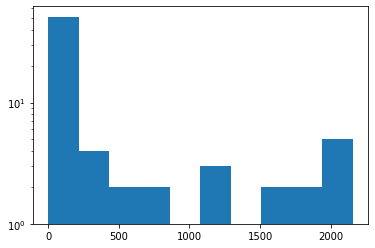

In [18]:
plt.hist(valuesHist, bins=10, log=True, bottom=True)

### 10) Visualice la ubicación de los terremotos haciendo un diagrama de dispersión de su latitud y longitud.

#### Usa los datos filtrados. Coloréalo por magnitud.



Ej. plt.scatter(x, y, s=s, c=c, cmap=plt.cm.Oranges)

Con s y c podemos modificar el tamaño y el color respectivamente. Para el color, a cada valor numérico se le asigna un color a través de un mapa de colores; ese mapa se puede cambiar con el argumento cmap. Esa correspondencia se puede visualizar llamando a la función colorbar.

```

N = 100
x = np.random.randn(N)
y = np.random.randn(N)
s = 50 + 50 * np.random.randn(N)
c = np.random.randn(N)

plt.scatter(x, y, s=s, c=c, cmap=plt.cm.Blues)
plt.colorbar()

```
Ref. adicional para colores: https://github.com/lsantiago/PythonBasico/raw/d36d9571a1ff6a2df8364a9055f71d70eddd9151/NumpyMatplotlib/plot_colormaps.png


In [19]:
dataScatter = by4Magnitud[["latitude", "longitude", "mag", "depth"]]
dataScatter

,latitude,longitude,mag,depth
id,,,,
usc000mqlp,-4.9758,153.9466,4.2,110.18
usc000mqln,-28.1775,-177.9058,4.3,95.84
usc000mqls,-23.1192,179.1174,4.4,528.34
usc000mf1x,51.1569,-178.0910,4.2,37.50
usc000mqlm,-4.8800,153.8434,4.3,112.66
...,...,...,...,...
usc000t6yh,21.2031,143.5484,4.4,11.05
usc000t6y2,-7.8798,106.4275,4.3,52.10
usc000t6y1,7.1429,126.8844,4.3,176.67


In [20]:
# Extraemos los datos a usar para facilitar el uso de las mismas
latitudes = dataScatter.iloc[:,0]
longitudes = dataScatter.iloc[:,1]
magnitudes = dataScatter.iloc[:,2]
profundidad = dataScatter.iloc[:,3]

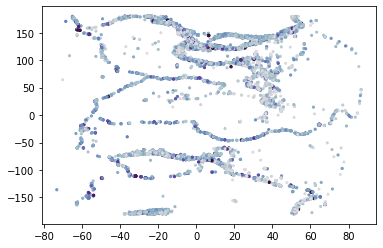

In [21]:
plt.scatter(latitudes, longitudes, s=magnitudes, c=magnitudes, cmap=plt.cm.twilight)

### 11) Haz lo mismo para la profundidad 

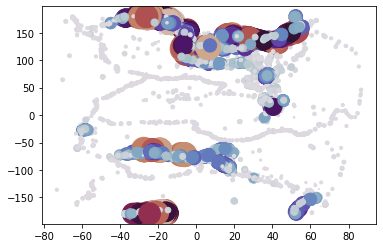

In [22]:
plt.scatter(latitudes, longitudes, s=profundidad, c=profundidad, cmap=plt.cm.twilight)